In [7]:
import sys
sys.path.append("/home/ipausers/lin/Desktop/AMF/AMFtrack")
import os
from amftrack.util.sys import storage_path
import imageio.v2 as imageio
import matplotlib.pyplot as plt
import cv2
%matplotlib widget
%load_ext autoreload
%autoreload 2
from amftrack.pipeline.functions.image_processing.extract_graph import (
    from_sparse_to_graph,
    generate_nx_graph,
    clean_degree_4,
)
import scipy
from amftrack.pipeline.functions.image_processing.node_id import remove_spurs
from amftrack.pipeline.functions.image_processing.extract_skel import remove_component, remove_holes
import numpy as np
from amftrack.pipeline.development.high_mag_videos.high_mag_videos_fun import *
from scipy import signal
from amftrack.pipeline.functions.image_processing.extract_skel import (
    extract_skel_new_prince,
    run_back_sub,
    bowler_hat,
)
from scipy.interpolate import griddata

from skimage.morphology import skeletonize
from amftrack.util.sys import temp_path
import pandas as pd
from PIL import Image
from scipy.optimize import curve_fit
from amftrack.pipeline.functions.image_processing.extract_skel import (
    extract_skel_new_prince,
    run_back_sub,
    bowler_hat,
)
sys.path.append("/home/ipausers/lin/Desktop/Kai/Graduation-Project/models/")
from make_dataset import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Try each parameters

In [8]:
images_path = r"/mnt/sun/shimizu-data/home-folder/Kaikai/Plate705_161122" #select images path 
# images_path = "/home/ipausers/lin/Desktop/Graduation/data/Plate705_161122/"
binning = 1
magnification = 50
space_pixel_size = 2*1.725/(magnification)*binning
files = os.listdir(images_path)
images_total_path = [os.path.join(images_path,file) for file in files]

In [9]:
selection_file = images_total_path
selection_file.sort()
#select image index
begin  = 8
image = imageio.imread(selection_file[begin])
# file_name = selection_file[begin].split('/')[-1].split('.')[0]
segmented,nx_graph_pruned,pos = segment_brightfield(image)

/tmp/ipykernel_166210/2414097263.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])
/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/home/ipausers/lin/Desktop/AMF/AMFtrack/am

In [10]:
edges = list(nx_graph_pruned.edges)
edges

[(0, 4), (4, 2), (4, 5)]

In [11]:
pos

{0: array([ 25, 826]),
 4: array([774, 948]),
 1: array([ 230, 2047]),
 2: array([ 303, 1997]),
 3: array([ 359, 2047]),
 5: array([1498,  994])}

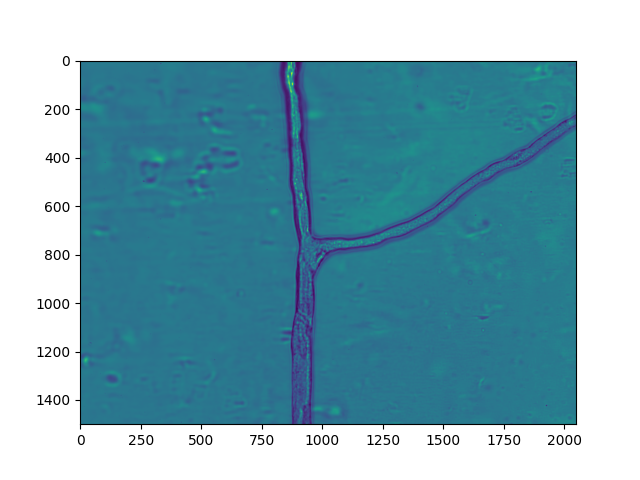

In [12]:
%matplotlib widget
fig, ax = plt.subplots()
ax.imshow(image)
# plt.imshow(image)
# plt.plot(image)

In [13]:
bound1 = 0
bound2 = 1
offset=100
step=30
target_length=120
resolution = 1
weight = 0.15

TypeError: extract_section_profiles_for_edge() got multiple values for argument 'resolution'

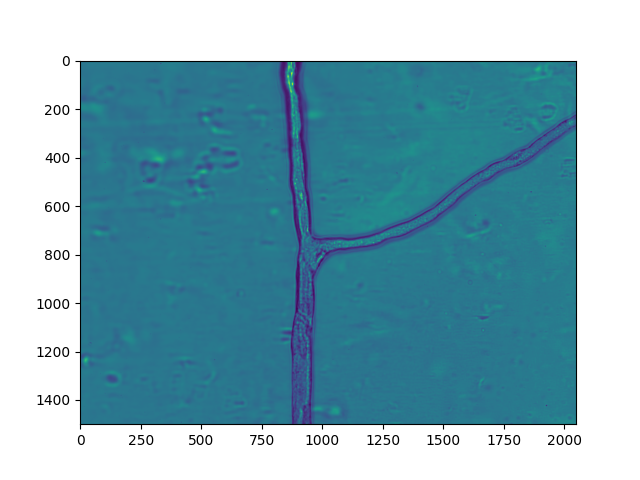

In [14]:
%matplotlib widget
fig, ax = plt.subplots()
ax.imshow(image)
for edge in edges:
    slices, segments = extract_section_profiles_for_edge(
    edge,
    pos,
    image,
    nx_graph_pruned,
    resolution=resolution,
    offset=offset,
    step=step,
    target_length=target_length,
    bound1=bound1,
    bound2=bound2)
    """
    extract_section_profiles_for_edge
    Main function to extract section profiles of an edge.
    Given an Edge of Experiment at timestep t, returns a np array
    of dimension (target_length, m) where m is the number of section
    taken on the hypha.
    :param resolution: distance between two measure points along the hypha
    :param offset: distance at the end and the start where no point is taken
    :param step: step in pixel to compute the tangent to the hypha
    :target_length: length of the section extracted in pixels
    :return: np.array of sections, list of segments in TIMESTEP referential
    """
    # width = round(get_width_from_graph_im(edge,pos,image,nx_graph_pruned,slice_length=400)*space_pixel_size,4)
    ax.text(*np.flip((1-weight) * pos[edge[0]]+weight*pos[edge[1]]),str(edge[0]),color="white")
    ax.text(*np.flip((1-weight) * pos[edge[1]]+weight*pos[edge[0]]),str(edge[1]),color="white")
    #plotting edge width
    # ax.text(*np.flip((1-0.5) * pos[edge[1]]+0.5*pos[edge[0]]),f'{width} $\mu m$',color="red")

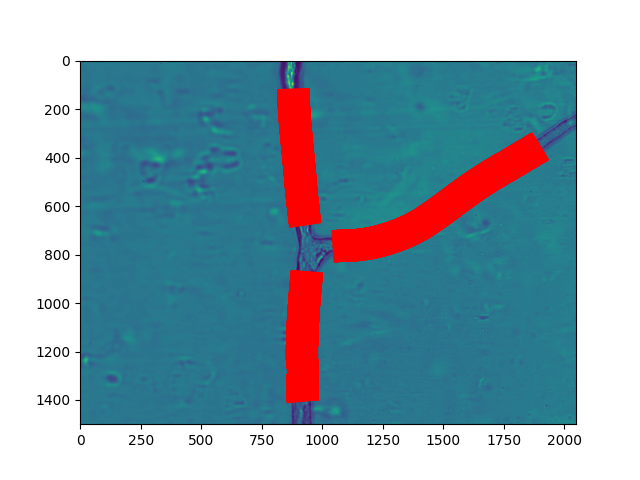

In [11]:
%matplotlib widget
bound1 = 0
bound2 = 1
offset=100
step=30
target_length=120
resolution = 1
weight = 0.15
fig, ax = plt.subplots()
ax.imshow(image)
for edge in edges:
    slices, segments = extract_section_profiles_for_edge(
    edge,
    pos,
    image,
    nx_graph_pruned,
    resolution=resolution,
    offset=offset,
    step=step,
    target_length=target_length,
    bound1=bound1,
    bound2=bound2)
    #plotting seqment width
    plot_segments_on_image(segments, ax)

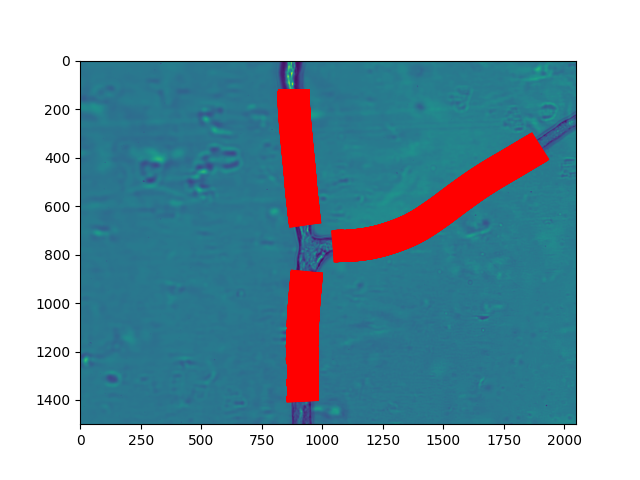

In [12]:
%matplotlib widget
bound1 = 0
bound2 = 1
offset=100
step=10
target_length=120
resolution = 1
weight = 0.15
fig, ax = plt.subplots()
ax.imshow(image)
for edge in edges:
    slices, segments = extract_section_profiles_for_edge(
    edge,
    pos,
    image,
    nx_graph_pruned,
    resolution=resolution,
    offset=offset,
    step=step,
    target_length=target_length,
    bound1=bound1,
    bound2=bound2)
    """
    extract_section_profiles_for_edge
    Main function to extract section profiles of an edge.
    Given an Edge of Experiment at timestep t, returns a np array
    of dimension (target_length, m) where m is the number of section
    taken on the hypha.
    :param resolution: distance between two measure points along the hypha
    :param offset: distance at the end and the start where no point is taken
    :param step: step in pixel to compute the tangent to the hypha
    :target_length: length of the section extracted in pixels
    :return: np.array of sections, list of segments in TIMESTEP referential
    """
    #plotting seqment width
    plot_segments_on_image(segments, ax)

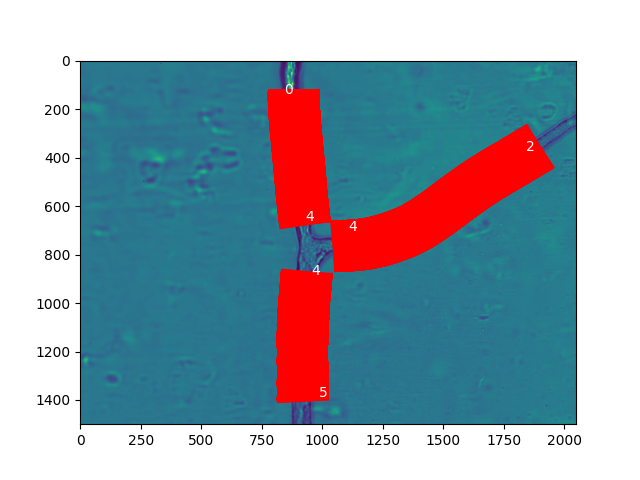

In [13]:
%matplotlib widget
bound1 = 0
bound2 = 1
offset=100
step=10
target_length=200
resolution = 1
weight = 0.15
fig, ax = plt.subplots()
ax.imshow(image)
for edge in edges:
    slices, segments = extract_section_profiles_for_edge(
    edge,
    pos,
    image,
    nx_graph_pruned,
    resolution=resolution,
    offset=offset,
    step=step,
    target_length=target_length,
    bound1=bound1,
    bound2=bound2)
    #plotting seqment width
    plot_segments_on_image(segments, ax)
    ax.text(*np.flip((1-weight) * pos[edge[0]]+weight*pos[edge[1]]),str(edge[0]),color="white")
    ax.text(*np.flip((1-weight) * pos[edge[1]]+weight*pos[edge[0]]),str(edge[1]),color="white")

In [14]:
select_exp = "/home/ipausers/lin/Desktop/Graduation/Kai/Graduation-Project/Experiment/Labelme/Fluorescence_ex_Kai-kai_Plate705.xlsx"
exp_df = pd.read_excel(select_exp,engine = "openpyxl",sheet_name="11.16",skiprows=1,index_col=0,header=0)
segment = get_labelme_segments("/home/ipausers/lin/Desktop/Graduation/Kai/Graduation-Project/Experiment/Labelme/Plate705_20221116/")
width_dict,width_std_dict= compute_width_from_segment(segment)
labelme_df = pd.DataFrame.from_dict(width_dict,orient='index')
labelme_df = labelme_df.sort_index()
for index, value in labelme_df.iterrows():
    if len(index.split("_")) == 2:
        pos, direction = index.split("_")
        exp_df.at[pos.lower(),direction]=value[0]
    if len(index.split("_")) == 3:
        pos, direction,direction2 = index.split("_")
        exp_df.at[pos.lower(),direction+direction2]=value[0]
exp_df = exp_df.iloc[:,9:]
exp_df["new_index"] = exp_df.index
exp_df["new_index"] = np.where(exp_df["new_index"].str.len() <=4, exp_df["new_index"].str.slice(stop=3)+"0"+exp_df["new_index"].str.slice(start=3), exp_df["new_index"])
exp_df = exp_df.set_index("new_index")
exp_df

,D,R,top,L,D1,D2,middle,middle2,middle3,focus1D,...,middle D2,R2,down,Ltop,LD,Lmiddle,Lmiddle2,Rtop,middleD,middletop
new_index,,,,,,,,,,,,,,,,,,,,,
pos01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.335141,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pos02,5.096730,4.853125,NaN,4.481460,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pos03,NaN,3.360181,5.466252,3.329234,NaN,NaN,6.101661,5.704716,NaN,NaN,...,NaN,NaN,5.97832,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pos04,4.738162,NaN,3.890178,NaN,NaN,NaN,4.940548,4.970713,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pos05,4.811456,2.815162,3.867490,3.271058,NaN,NaN,4.886012,4.084507,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pos60,6.794172,7.723462,8.546125,5.528969,NaN,NaN,8.260645,7.327132,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pos61,NaN,3.494587,NaN,3.295571,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,2.635567,NaN,NaN,NaN,2.356413,2.938713,2.809692
pos62,NaN,4.441835,3.247844,4.304565,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos02


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos06


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos07


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos08


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos09


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos10


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos11


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos12


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos13


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos14


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos15


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos16


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos17


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos19


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos20


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos21


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos22


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos24


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos25


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos26


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos28


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos29


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos31


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos32


/home/ipausers/lin/Desktop/Graduation/project/lib/python3.8/site-packages/skimage/filters/ridges.py:479: RuntimeWarning: overflow encountered in square
  r_g = sum([lambda1 ** 2] + [lambdai ** 2 for lambdai in lambdas])
/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos33


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos34


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos35


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos36


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos37


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos38


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos42


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos45


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos46


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos47


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos49


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos50


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos51


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos53


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos54


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos55


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos56


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos57


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos58


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos59


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos62


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos63


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)
/tmp/ipykernel_3922451/2254365377.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


loading pos64


/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)


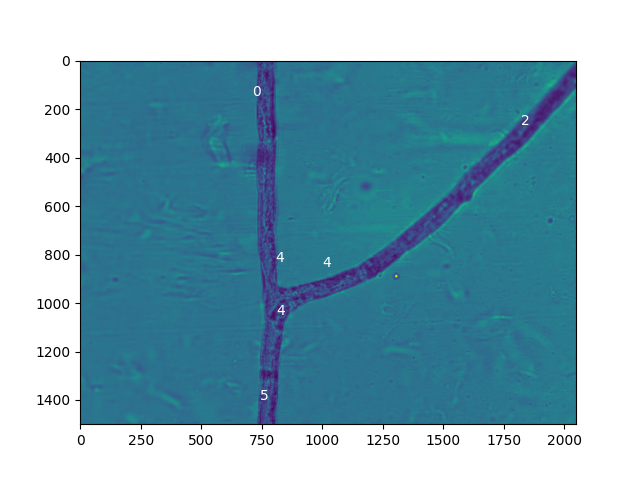

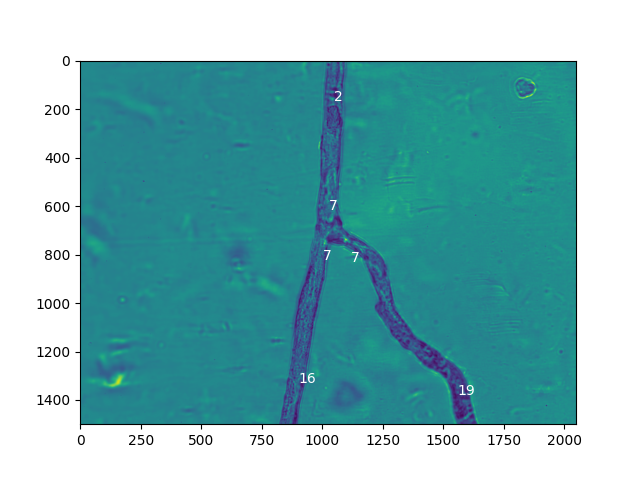

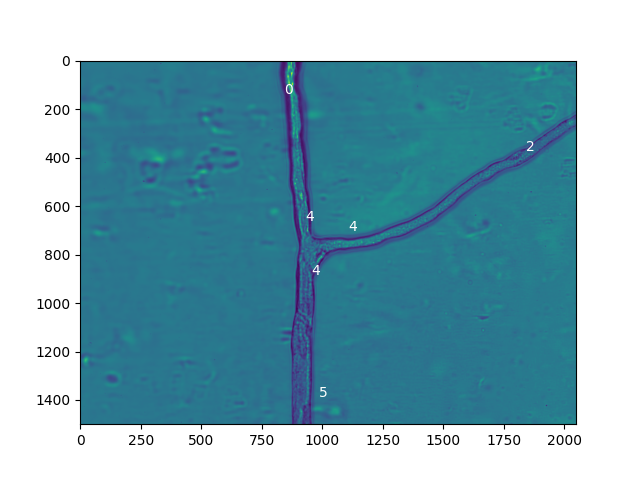

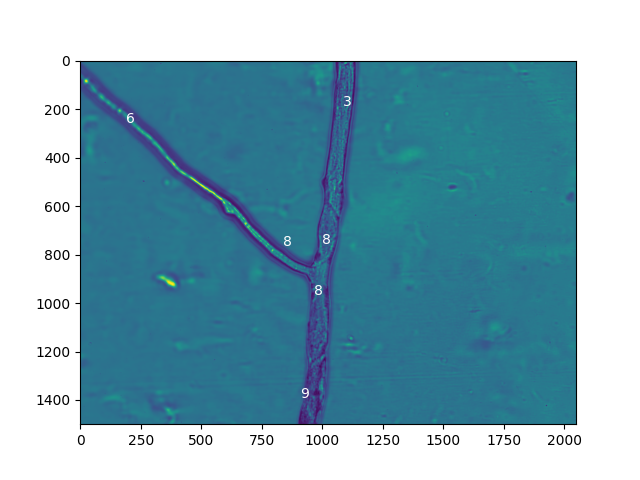

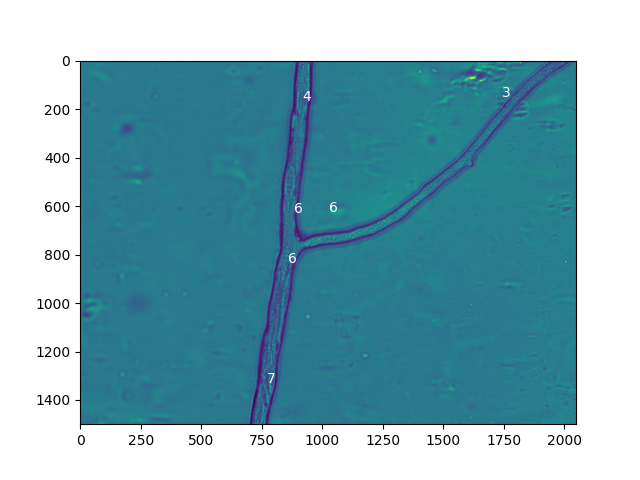

...

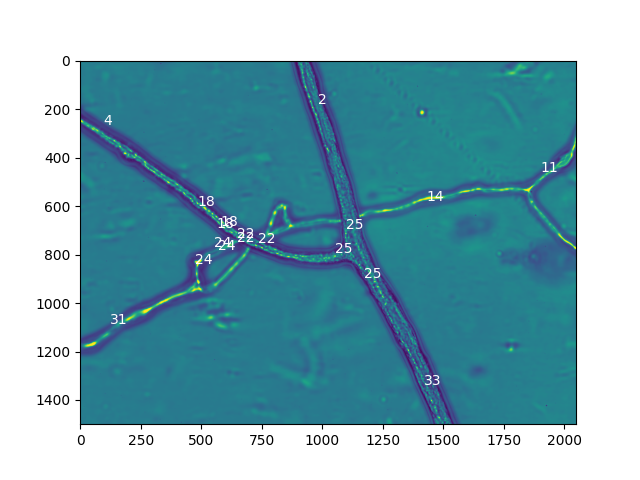

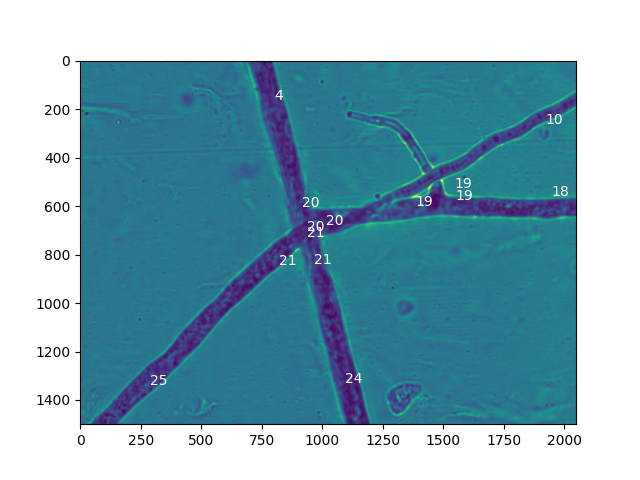

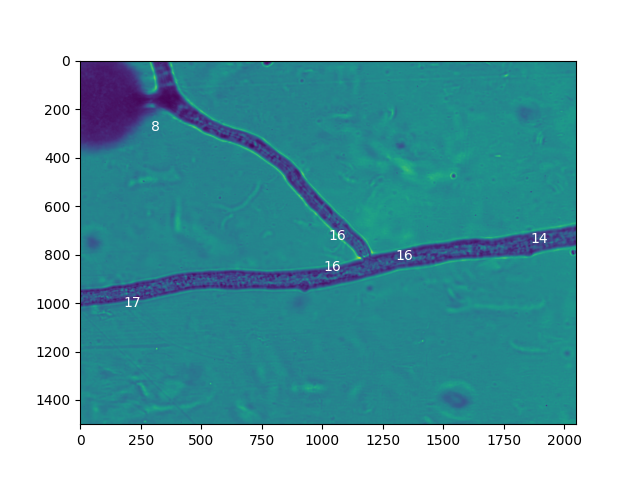

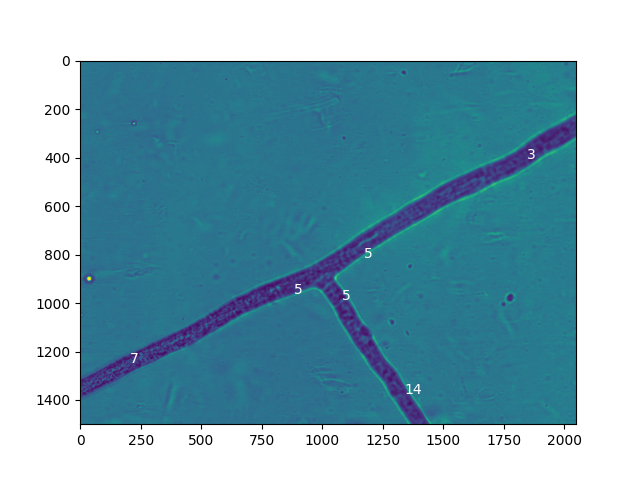

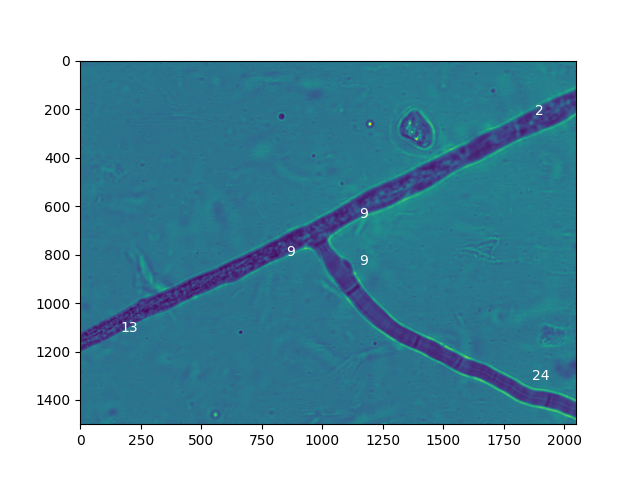

In [43]:
# To get the edge and the correspond order to the labelme ground truth
collect_edges=[]
collect_name=[]
for begin in range(3,len(selection_file)):
    image = imageio.imread(selection_file[begin])
    file_name = selection_file[begin].split('/')[-1].split('.')[0]
    row = exp_df.loc[file_name].dropna()
    if len(row) <= 4:
        print(f"loading {file_name}")
        segmented,nx_graph_pruned,pos = segment_brightfield(image)
        edges = list(nx_graph_pruned.edges)
        fig, ax = plt.subplots()
        ax.imshow(image)
        # bound1 = 0
        # bound2 = 1
        # offset=100
        # step=30
        # target_length=130
        # resolution = 1
        # weight = 0.15
        for edge in edges:
            # slices, segments = extract_section_profiles_for_edge(
            # edge,
            # pos,
            # image,
            # nx_graph_pruned,
            # resolution=resolution,
            # offset=offset,
            # step=step,
            # target_length=target_length,
            # bound1=bound1,
            # bound2=bound2)
            ax.text(*np.flip((1-weight) * pos[edge[0]]+weight*pos[edge[1]]),str(edge[0]),color="white")
            ax.text(*np.flip((1-weight) * pos[edge[1]]+weight*pos[edge[0]]),str(edge[1]),color="white")
        collect_edges.append(edges)
        collect_name.append(file_name)

In [59]:
select_exp = "/home/ipausers/lin/Desktop/Graduation/Kai/Graduation-Project/Experiment/Labelme/Fluorescence_ex_Kai-kai_Plate705.xlsx"
ML_df = pd.read_excel(select_exp,engine = "openpyxl",sheet_name="50X_ML",index_col=0,header=0)
ML_df

,edges,labelme_label,order_1,order_2,order_3,order_4
pos,,,,,,
pos02,"[(0, 4), (4, 2), (4, 5)]",DRL,L,R,D,NaN
pos06,"[(2, 7), (7, 16), (7, 19)]",DRtop,top,D,R,NaN
pos07,"[(0, 4), (4, 2), (4, 5)]",DRtop,top,R,D,NaN
pos08,"[(3, 8), (8, 9), (8, 6)]",DtopL,top,D,L,NaN
pos09,"[(4, 6), (3, 6), (6, 7)]",DRtop,top,R,D,NaN
pos10,"[(0, 4), (4, 2), (4, 5)]",DRtop,top,R,D,NaN
pos11,"[(0, 10), (10, 11), (10, 2)]",DRtop,top,D,R,NaN
pos12,"[(0, 8), (8, 2), (8, 9)]",DRtop,top,R,D,NaN
pos13,"[(2, 7), (7, 17), (7, 12)]",DRtop,top,D,R,NaN


## Create dataset

In [60]:
images_path = r"/mnt/sun/shimizu-data/home-folder/Kaikai/Plate705_161122"
binning = 1
magnification = 50
space_pixel_size = 2*1.725/(magnification)*binning
files = os.listdir(images_path)
images_total_path = [os.path.join(images_path,file) for file in files]
selection_file = images_total_path
selection_file.sort()

In [ ]:
# test for all
collect_slice = []
collect_labels = []
order_label = ["order_1","order_2","order_3","order_4"]
check =0
for begin in range(len(selection_file)):
    file_name = selection_file[begin].split('/')[-1].split('.')[0]
    try:
        row = exp_df.loc[file_name].dropna()
        if len(row) <= 3:
            print(f'{file_name} is loading.')
            image = imageio.imread(selection_file[begin])
            segmented, nx_graph_pruned, pos = segment_brightfield(image)
            edges = list(nx_graph_pruned.edges)
            bound1 = 0
            bound2 = 1
            offset=100
            step=30
            target_length=200
            resolution = 1
            weight = 0.15
            count = -1
            #for plot
            fig, ax = plt.subplots()
            ax.imshow(image)
            for edge in edges:
                if count < 3:
                    count+=1
                try:
                    position = ML_df.loc[file_name][order_label[count]]
                    width = exp_df.loc[file_name][position]
                    slices, segments = extract_section_profiles_for_edge(
                        edge,
                        pos,
                        image,
                        nx_graph_pruned,
                        resolution=resolution,
                        offset=offset,
                        step=step,
                        target_length=target_length,
                        bound1=bound1,
                        bound2=bound2)
                    slices = slices[len(slices)//4:-len(slices)//4]
                    # for dataset                    
                    collect_slice.extend(slices)
                    collect_labels.extend(len(slices)*[width])
                    # for checking the segments                     
                    plot_segments_on_image(segments, ax)
                    ax.text(*np.flip((1-weight) * pos[edge[0]]+weight*pos[edge[1]]),str(edge[0]),color="white")
                    ax.text(*np.flip((1-weight) * pos[edge[1]]+weight*pos[edge[0]]),str(edge[1]),color="white")
                except KeyError:
                    print(f'{file_name} {order_label[count]} cannot find')
                    continue
    except KeyError:
        print(f'The file {file_name} will not be extract.')

The file pos01_focus1 will not be extract.
The file pos01_focus2 will not be extract.
The file pos01_focus3 will not be extract.
pos02 is loading.


/tmp/ipykernel_3922451/1933102186.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])
/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)


pos06 is loading.


/tmp/ipykernel_3922451/1933102186.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])
/home/ipausers/lin/Desktop/AMF/AMFtrack/amftrack/pipeline/functions/image_processing/extract_graph.py:170: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  graph = graph.append(pd.DataFrame(edges[branch]), ignore_index=True)


pos07 is loading.


/tmp/ipykernel_3922451/1933102186.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(selection_file[begin])


In [106]:
slice_array = np.array(collect_slice)
label_array = np.array(collect_labels)
print(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")

Slice array: (38111, 200) Label array: (38111,)


In [107]:
print(sum(sum(np.isnan(slice_array))))
print(sum(np.isnan(label_array)))

0
0


In [108]:
if not os.path.join(storage_path, "50X_groundtruth_dataset"):
    os.mkdir(os.path.join(storage_path, "50X_groundtruth_dataset"))
cv2.imwrite(os.path.join(storage_path, "50X_groundtruth_dataset","slices.png"), slice_array)
with open(os.path.join(storage_path, "50X_groundtruth_dataset","labels.npy"), "wb") as f:
    np.save(f, label_array)
with open(os.path.join(storage_path, "50X_groundtruth_dataset","info.txt"), "w") as f:
    f.write(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")
    f.write('\nPlate number 705\nStrain: C2\nCrossdate: 10/14\nPrince position: 21\nPRINCE FULL DATA: 20221116_0311_Plate21')

In [113]:
storage = "/home/ipausers/lin/Desktop/Graduation/Kai/Graduation-Project/datasets/"
if not os.path.join(storage, "50X_groundtruth_dataset"):
    os.mkdir(os.path.join(storage, "50X_groundtruth_dataset"))
cv2.imwrite(os.path.join(storage, "50X_groundtruth_dataset","slices.png"), slice_array)
with open(os.path.join(storage, "50X_groundtruth_dataset","labels.npy"), "wb") as f:
    np.save(f, label_array)
with open(os.path.join(storage, "50X_groundtruth_dataset","info.txt"), "w") as f:
    f.write(f"Slice array: {slice_array.shape} Label array: {label_array.shape}")
    f.write('\nPlate number 705\nStrain: C2\nCrossdate: 10/14\nPrince position: 21\nPRINCE FULL DATA: 20221116_0311_Plate21')

In [114]:
os.path.join(storage, "50X_groundtruth_dataset")

'/home/ipausers/lin/Desktop/Graduation/Kai/Graduation-Project/datasets/50X_groundtruth_dataset'

## Tuning 

In [117]:
import tensorflow as tf
import sys, imageio, os
sys.path.append("/home/ipausers/lin/Desktop/Graduation/Kai/Graduation-Project/")
from config import *
from models.data_prepare import *
from models.model import *
import keras
X, y=data("50X_groundtruth_dataset")
print(X.shape,y.shape)
print(sum(sum(np.isnan(X))))
print(sum(np.isnan(y)))
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42,shuffle=True)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

(38111, 200) (38111, 1)
0
[0]


((26677, 200), (11434, 200), (26677, 1), (11434, 1))

In [120]:
callbacks = [
    keras.callbacks.EarlyStopping(
        # Stop training when `val_loss` is no longer improving
        # "no longer improving" being defined as "no better than 1e-3 less"
        # "no longer improving" being further defined as "for at least 3 epochs"
        monitor="val_loss",
        min_delta=1e-3,
        patience=3,
        verbose=1),]

In [ ]:
tuner_BO = tuning_model(build_model_CNN, callbacks, 
                        X_train, y_train, X_test, y_test, 
                        model_type="BO", 
                        project="/home/ipausers/lin/Desktop/Graduation/Kai/Graduation-Project/models/GroundTruthML")

Trial 11 Complete [04h 48m 26s]
val_mean_absolute_error: 0.751400887966156

Best val_mean_absolute_error So Far: 0.488460898399353
Total elapsed time: 12h 41m 07s

Search: Running Trial #12

Value             |Best Value So Far |Hyperparameter
200               |200               |input
4                 |3                 |num_conv_layers
64                |192               |filters_1
18                |15                |kernel_size_0
1.4438e-05        |6e-05             |kernel_regulizer
0.02441           |0.00026644        |activity_regulizer
128               |128               |filters_2
17                |12                |kernel_size_1
MP                |No pool           |pooling_1
valid             |valid             |padding_1
3                 |4                 |MP
False             |True              |batch_normalization
4                 |4                 |num_dense_layers
232               |200               |dense_size
0.2               |0.1               |dropout_1

In [1]:
best_model, best_model_hp, history = hp_model_output_information(tuner_BO,X_train, y_train, X_test, y_test)
best_model.save("/home/ipausers/lin/Desktop/Graduation/Kai/Graduation-Project/models/bin2_HB_without_crop_best_model_val_version")

finish
